In [91]:
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import os

# dirpath = "/home/LafiscaL/TRAIL_2023/rep-path-reasoning-recsys"
# os.chdir(dirpath)

# # Load the data
# data_dir = "data/ml1m/preprocessed/"
# kg = pd.read_csv(data_dir+'kg_final.txt', sep='\t', names=['entity_head', 'relation', 'entity_tail'])
# users = pd.read_csv(data_dir+'users.txt', sep='\t', names=['uid', 'gender', 'age'])
# ratings = pd.read_csv(data_dir+'ratings.txt', sep='\t', names=['uid', 'pid', 'rating', 'timestamp'])
# e_map = pd.read_csv(data_dir+'e_map.txt', sep='\t', names=['eid', 'name', 'entity'])
# r_map = pd.read_csv(data_dir+'r_map.txt', sep='\t', names=['id', 'kb_relation', 'name'])

# # Creating a dictionary for entity names and relations
# entity_dict = e_map.set_index('eid').to_dict()['name']
# relation_dict = r_map.set_index('id').to_dict()['name']

# # Create dictionaries for quick lookup
# kg_dict = {}
# for _, row in kg.iterrows():
#     head, relation, tail = row['entity_head'], row['relation'], row['entity_tail']
#     if head not in kg_dict:
#         kg_dict[head] = []
#     kg_dict[head].append((relation, tail))

# ratings_dict = {}
# for _, row in ratings.iterrows():
#     uid, pid, rating = row['uid'], row['pid'], row['rating']
#     if uid != 'uid':
#         uid = int(uid)
#     if uid not in ratings_dict:
#         ratings_dict[uid] = []
#     ratings_dict[uid].append((pid, rating))
    
# # Read the mapping file to map the movie IDs
# mapping_dict = {}
# with open("data/ml1m/preprocessed/pgpr/mappings/product_mapping.txt", "r") as file:
#     next(file)  # Skip the header
#     for line in file:
#         rating_id, new_id = line.strip().split("\t")
#         mapping_dict[int(new_id)] = int(rating_id)


/tmp/ipykernel_2169235/4262411077.py:13: DtypeWarning: Columns (0,1,2,3) have mixed types. Specify dtype option on import or set low_memory=False.
  ratings = pd.read_csv(data_dir+'ratings.txt', sep='\t', names=['uid', 'pid', 'rating', 'timestamp'])


In [ ]:
# Extracting nodes from the recommendation path
# recommendation_path = [('self_loop', 'user', 0), ('watched', 'product', 2787), 
#                        ('watched', 'user', 1906), ('watched', 'product', 2273)]

# recommendation_path = [('self_loop', 'user', 0), ('watched', 'product', 1930),
#                        ('watched', 'user', 3914), ('watched', 'product', 2585)]

In [217]:
def create_subgraph(recommendation_path, entity_dict=entity_dict, relation_dict=relation_dict, kg_dict=kg_dict, ratings_dict=ratings_dict):
    # Initialize graph
    G = nx.DiGraph()

    # Adding nodes and edges to the graph
    primary_nodes = set()
    secondary_nodes = set()
    tertiary_nodes = set()
    primary_products = []
    for relation, node_type, node_id in recommendation_path:
        if node_type == 'user':
            node_name = f"user_{node_id}"
        else:
            node_name = entity_dict[f'{node_id}']
            primary_products.append(node_id)

        G.add_node(node_name, type=node_type)
        primary_nodes.add(node_name)

        if relation == 'self_loop':
            continue
        elif relation == 'watched':
            last_node_name = list(G.nodes)[-2]
            G.add_edge(last_node_name, node_name, relation='watched')

    # Adding ratings information to the graph as second hop
    for user_node in primary_nodes:
        if user_node.startswith("user_"):
            uid = int(user_node.split('_')[1]) + 1
            if uid in ratings_dict:
                for pid, rating in ratings_dict[uid]:
                    for idx, value in mapping_dict.items():
                        if value == int(pid):
                            product_node = f'{idx}'
                            break
                    product_name = entity_dict[product_node]
                    if product_name not in G.nodes:
                        G.add_node(product_name, type='product')
                        secondary_nodes.add(product_name)
                    G.add_edge(user_node, product_name, relation='rated', rating=rating)

                    # Add knowledge graph edges related to these product nodes
                    if product_node in kg_dict:
                        for relation, tail in kg_dict[product_node]:
                            if relation != '3' and relation != '10':
                                tail_name = entity_dict.get(tail, tail)
                                relation_name = relation_dict.get(relation, relation)
                                if tail_name not in G.nodes:
                                    G.add_node(tail_name)
                                G.add_edge(product_name, tail_name, relation=relation_name)
                            
    for pid in primary_products:
        product_node = f'{pid}'
        product_name = entity_dict[f'{pid}']
        # Add knowledge graph edges related to these product nodes
        if product_node in kg_dict:
            for relation, tail in kg_dict[product_node]:
                if relation != '3' and relation != '10':
                    tail_name = entity_dict.get(tail, tail)
                    relation_name = relation_dict.get(relation, relation)
                    G.add_edge(product_name, tail_name, relation=relation_name)
                    tertiary_nodes.add(tail_name)

    return G, primary_nodes, secondary_nodes, tertiary_nodes


In [218]:
# G, primary_nodes, secondary_nodes, tertiary_nodes = create_subgraph(recommendation_path)

In [176]:
# Apply PageRank
def pagerank_subgraph(G, display=True):
    page_rank_scores = nx.pagerank(G)

    # Print the PageRank scores
    if display:
        # Sort the PageRank scores in descending order
        sorted_scores = sorted(page_rank_scores.items(), key=lambda x: x[1], reverse=True)
        for node, score in sorted_scores:
            print(f"Node: {node}, PageRank Score: {score:.4f}")
        
    return page_rank_scores


In [219]:
# scores = pagerank_subgraph(G)

Node: Warner_Bros., PageRank Score: 0.0036
Node: Paramount_Pictures, PageRank Score: 0.0035
Node: Walt_Disney_Studios_Motion_Pictures, PageRank Score: 0.0033
Node: Germany, PageRank Score: 0.0032
Node: Philippe_Sarde, PageRank Score: 0.0030
Node: John_Williams, PageRank Score: 0.0029
Node: 20th_Century_Fox, PageRank Score: 0.0029
Node: Walt_Disney_Animation_Studios, PageRank Score: 0.0028
Node: Elmer_Bernstein, PageRank Score: 0.0028
Node: Metro-Goldwyn-Mayer, PageRank Score: 0.0028
Node: Walt_Disney_Pictures, PageRank Score: 0.0027
Node: Universal_Studios, PageRank Score: 0.0027
Node: Randy_Newman, PageRank Score: 0.0025
Node: RKO_Pictures, PageRank Score: 0.0025
Node: United_States, PageRank Score: 0.0024
Node: Amblin_Entertainment, PageRank Score: 0.0024
Node: Columbia_Pictures, PageRank Score: 0.0024
Node: Frank_Churchill, PageRank Score: 0.0023
Node: BBC, PageRank Score: 0.0023
Node: Peter_Sallis, PageRank Score: 0.0023
Node: Alan_Menken, PageRank Score: 0.0023
Node: Michael_Kahn_

In [212]:
# Draw the sub-graph
def plot_subgraph(G, primary_nodes, secondary_nodes, tertiary_nodes, last_hop=False, scale_edges=True, scores=None, save=False, savepath=None):
    plt.figure(figsize=(75, 75))
    
    # Separate primary and secondary nodes for shell layout
    outer_nodes = set(G.nodes()) - primary_nodes - secondary_nodes - tertiary_nodes
    if last_hop:
        pos = nx.shell_layout(G, nlist=[list(primary_nodes), list(secondary_nodes), list(tertiary_nodes), list(outer_nodes)])
    else:
        G.remove_nodes_from(outer_nodes)
        pos = nx.shell_layout(G, nlist=[list(primary_nodes), list(secondary_nodes), list(tertiary_nodes)])
#     pos = nx.spring_layout(G, k=0.5)  # positions for all nodes
    
    # Draw nodes
    nx.draw_networkx_nodes(G, pos, node_size=500)
    
    if scale_edges:    
        # Normalize PageRank scores for edge width scaling
        min_pr, max_pr = min(scores.values()), max(scores.values())
        pr_width_scale = {node: 1 + 5 * (score - min_pr) / (max_pr - min_pr) for node, score in scores.items()}

        # Draw edges with widths based on PageRank scores
        edge_widths = [pr_width_scale[u] for u, v in G.edges()]
        nx.draw_networkx_edges(G, pos, width=edge_widths, alpha=0.5)
        
    else:
        # edges
        nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.5)

    # labels
    nx.draw_networkx_labels(G, pos, font_size=10, font_family="sans-serif")
    
    # Create edge labels for ratings
    edge_labels = {(u, v): f"{d['rating']}/5" for u, v, d in G.edges(data=True) if 'rating' in d}
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_color='red')


    plt.title("Sub-Graph Related to Recommendation Path")
    plt.show()

    # Output the graph to a file if needed
    if save:
        nx.write_graphml(G, f"{savepath}/subgraph.graphml")


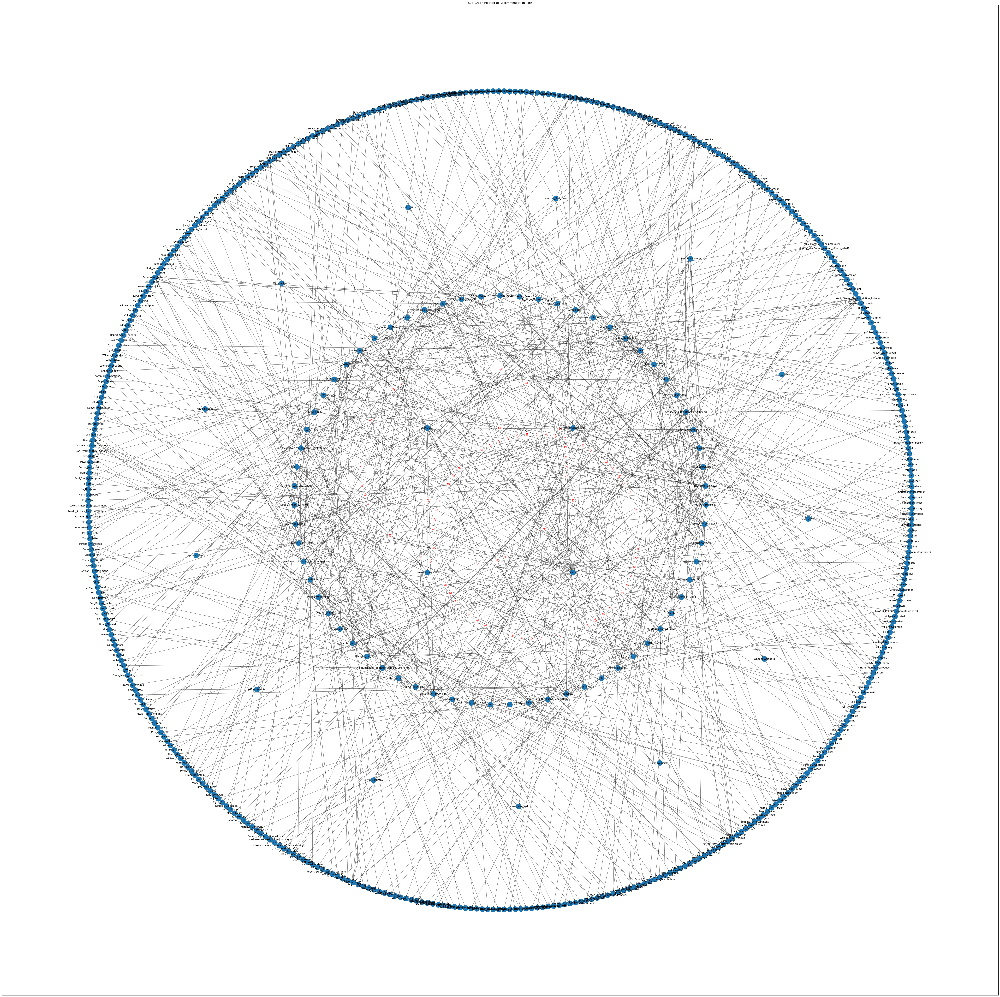

In [220]:
# plot_subgraph(G, primary_nodes, secondary_nodes, tertiary_nodes, last_hop=True, scores=scores)